In [1]:
#import matplotlib
#matplotlib.use("tkagg")
#matplotlib.interactive(False) 

from matplotlib.path import Path
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import cv2
import os

import keyboard as kb
import pathlib

In [2]:
# Data
filename = './data/meta_data.hdf'
data = pd.read_hdf(filename,'/d')
data.head()

,building_id,image_buffer,image_provider,b_outline,b_surfaces,panel_polygons,panel_centroids
0,78a6cd53-5fe9-4a91-b328-be04817f73f1,15,C,"[[378, 112], [378, 387], [121, 387], [121, 112...","[[392, 134], [152, 404], [213, 450], [453, 180...","[[[172, 367], [154, 353], [164, 342], [182, 35...","[[168, 355], [149, 341], [178, 343], [159, 329..."
0,8724d454-483a-4e0d-8e4b-1f45666fd0c6,15,C,"[[395, 131], [395, 368], [104, 368], [104, 131...","[[[248, 335], [196, 184], [125, 223], [132, 24...","[[[142, 227], [159, 218], [164, 233], [148, 24...","[[153, 230], [170, 221], [187, 211], [176, 237..."
0,41f7159f-7cd1-45ab-87b1-1fa761ff2aba,15,C,"[[330, 130], [330, 369], [169, 369], [169, 130...","[[225, 298], [203, 424], [345, 439], [392, 171...","[[[281, 355], [246, 352], [250, 332], [284, 33...","[[265, 344], [230, 340], [195, 337], [269, 324..."
0,4df4d98d-4042-47c0-8331-1f63a5e536c7,15,C,"[[387, 145], [387, 354], [112, 354], [112, 145...","[[[260, 294], [246, 209], [165, 145], [139, 20...","[[[241, 232], [228, 259], [215, 249], [228, 22...","[[228, 240], [214, 230], [201, 219], [188, 209..."
0,71c524ac-1c82-4ba7-9731-0fc0d0f970a2,15,C,"[[329, 136], [126, 297], [171, 363], [174, 360...","[[394, 164], [152, 357], [205, 435], [209, 432...","[[[177, 353], [164, 335], [178, 323], [191, 34...","[[177, 338], [164, 319], [151, 301], [192, 327..."


In [3]:
def mask_image_creation (n,p,surfaces) : 
    # One polygone
    if (len(surfaces[0])==2) : 
        x, y = np.meshgrid(np.arange(n), np.arange(p))
        x, y = x.flatten(), y.flatten()
        points = np.vstack((x,y)).T
        path = Path(surfaces)
        grid = path.contains_points(points)
        grid = grid.reshape((n,p))
    # Multiples polygones
    else :
        grid = np.reshape([False for i in range (n*p)],(n,p))
        for i,polygons in enumerate(surfaces) : 
            x, y = np.meshgrid(np.arange(n), np.arange(p))
            x, y = x.flatten(), y.flatten()
            points = np.vstack((x,y)).T
            path = Path(polygons)
            grid_2 = path.contains_points(points)
            grid_2 = grid_2.reshape((n,p))
            grid = np.add(grid,grid_2)
    
    return (grid.T)

def image_reader (image_data) : 
    surfaces = image_data.b_surfaces
    # One polygone
    if (len(surfaces[0])==2) : 
        plt.plot(np.array(surfaces)[:,1],np.array(surfaces)[:,0], label = 'surface', c = 'r')
    # Multiples polygones
    else :
        for polygons in surfaces : 
            plt.plot(np.array(polygons)[:,1],np.array(polygons)[:,0], label = 'surface', c = 'r')
    return 0

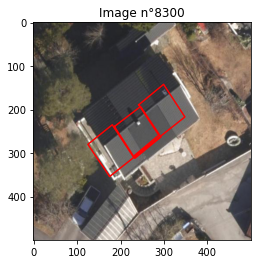

Do we accept the picture n°8300 ? (y/n/s (stop))n
not passed


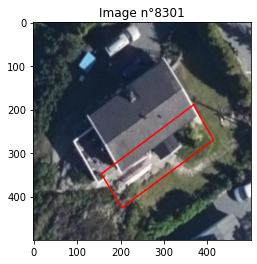

Do we accept the picture n°8301 ? (y/n/s (stop))n
not passed


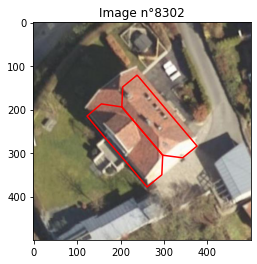

Do we accept the picture n°8302 ? (y/n/s (stop))y
passed


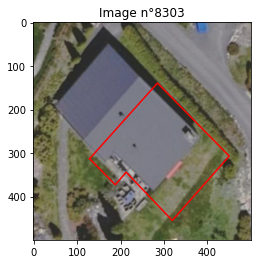

Do we accept the picture n°8303 ? (y/n/s (stop))n
not passed


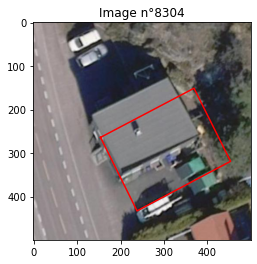

Do we accept the picture n°8304 ? (y/n/s (stop))n
not passed


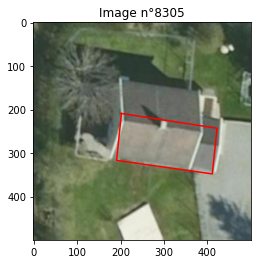

Do we accept the picture n°8305 ? (y/n/s (stop))n
not passed


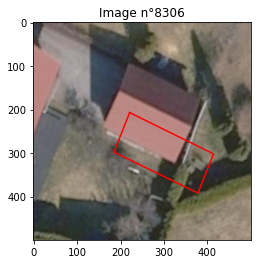

Do we accept the picture n°8306 ? (y/n/s (stop))n
not passed


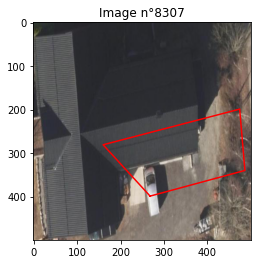

Do we accept the picture n°8307 ? (y/n/s (stop))n
not passed


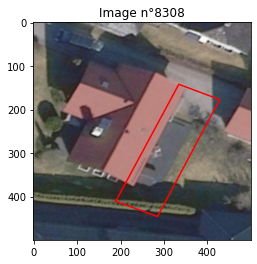

Do we accept the picture n°8308 ? (y/n/s (stop))n
not passed


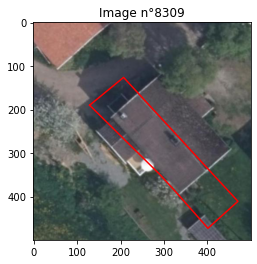

Do we accept the picture n°8309 ? (y/n/s (stop))n
not passed


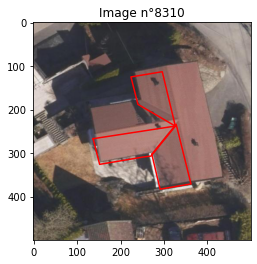

Do we accept the picture n°8310 ? (y/n/s (stop))y
passed


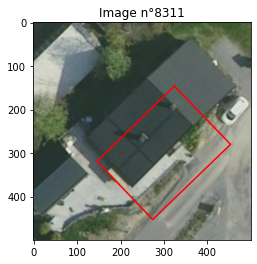

Do we accept the picture n°8311 ? (y/n/s (stop))n
not passed


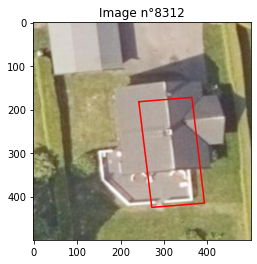

Do we accept the picture n°8312 ? (y/n/s (stop))n
not passed


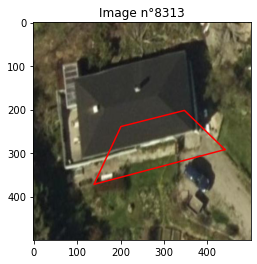

Do we accept the picture n°8313 ? (y/n/s (stop))n
not passed


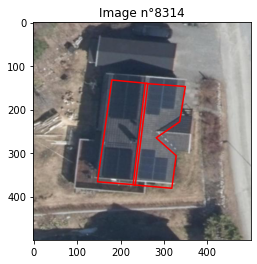

Do we accept the picture n°8314 ? (y/n/s (stop))y
passed


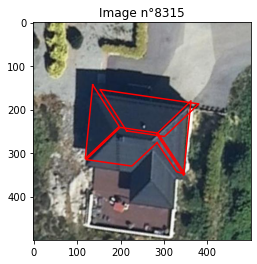

Do we accept the picture n°8315 ? (y/n/s (stop))y
passed


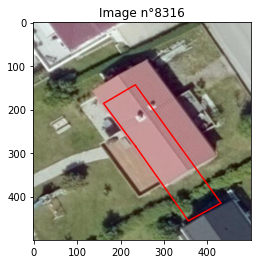

Do we accept the picture n°8316 ? (y/n/s (stop))n
not passed


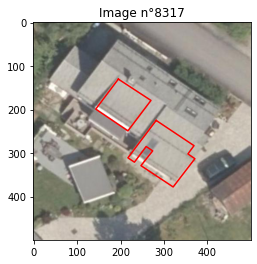

Do we accept the picture n°8317 ? (y/n/s (stop))y
passed


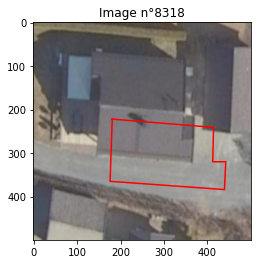

Do we accept the picture n°8318 ? (y/n/s (stop))n
not passed


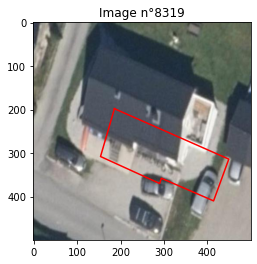

Do we accept the picture n°8319 ? (y/n/s (stop))n
not passed


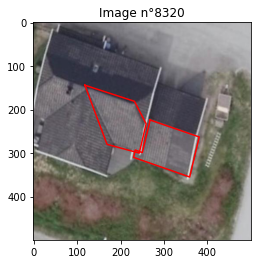

Do we accept the picture n°8320 ? (y/n/s (stop))y
passed


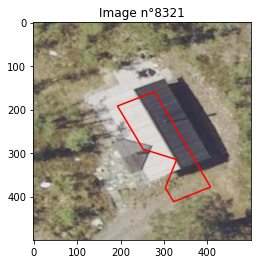

Do we accept the picture n°8321 ? (y/n/s (stop))n
not passed


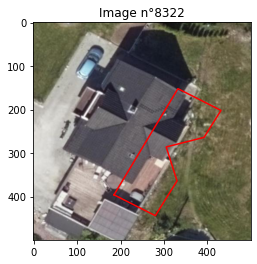

Do we accept the picture n°8322 ? (y/n/s (stop))n
not passed


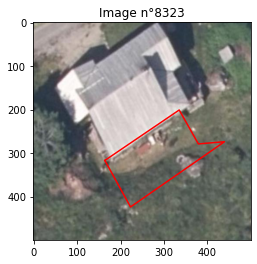

Do we accept the picture n°8323 ? (y/n/s (stop))n
not passed


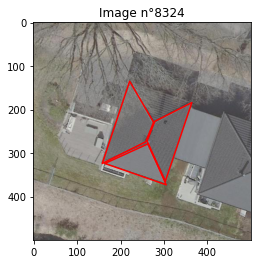

Do we accept the picture n°8324 ? (y/n/s (stop))y
passed


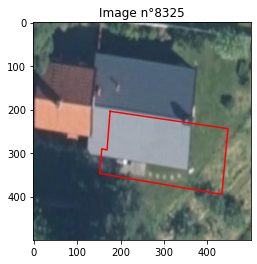

Do we accept the picture n°8325 ? (y/n/s (stop))n
not passed


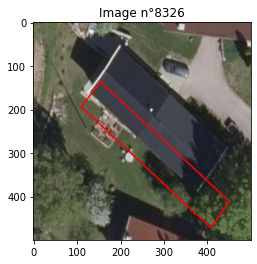

Do we accept the picture n°8326 ? (y/n/s (stop))n
not passed


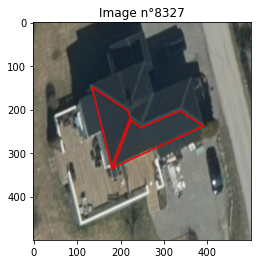

Do we accept the picture n°8327 ? (y/n/s (stop))y
passed


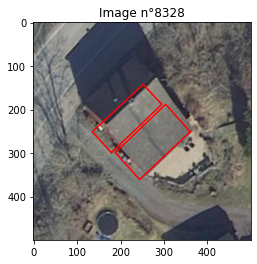

Do we accept the picture n°8328 ? (y/n/s (stop))y
passed


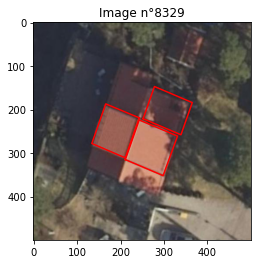

Do we accept the picture n°8329 ? (y/n/s (stop))y
passed


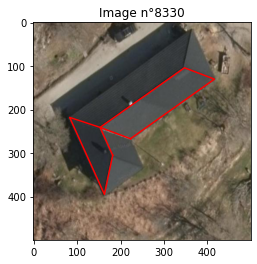

Do we accept the picture n°8330 ? (y/n/s (stop))y
passed


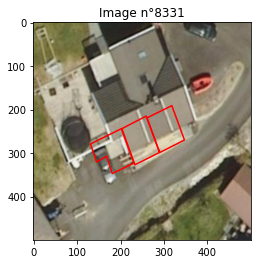

Do we accept the picture n°8331 ? (y/n/s (stop))n
not passed


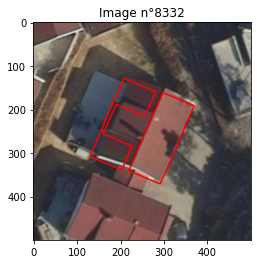

Do we accept the picture n°8332 ? (y/n/s (stop))y
passed


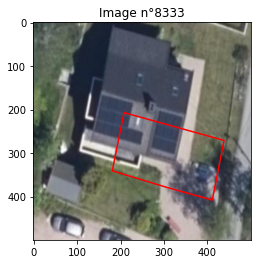

Do we accept the picture n°8333 ? (y/n/s (stop))n
not passed


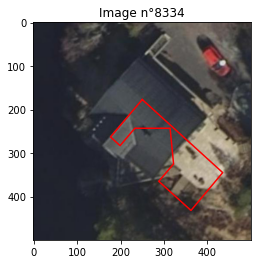

Do we accept the picture n°8334 ? (y/n/s (stop))n
not passed


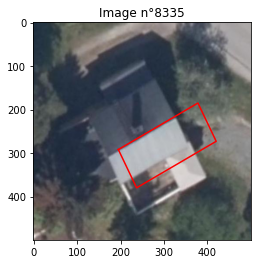

Do we accept the picture n°8335 ? (y/n/s (stop))n
not passed


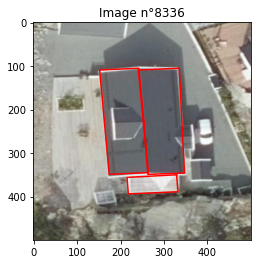

Do we accept the picture n°8336 ? (y/n/s (stop))y
passed


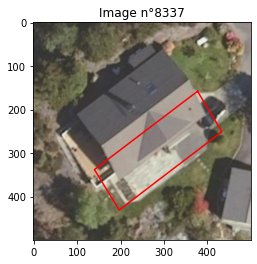

Do we accept the picture n°8337 ? (y/n/s (stop))n
not passed


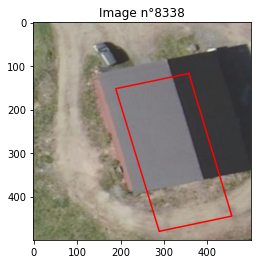

Do we accept the picture n°8338 ? (y/n/s (stop))n
not passed


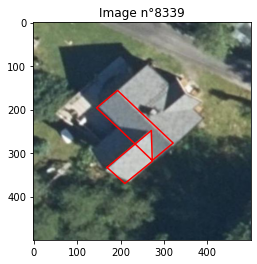

Do we accept the picture n°8339 ? (y/n/s (stop))y
passed


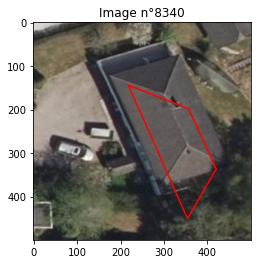

Do we accept the picture n°8340 ? (y/n/s (stop))n
not passed


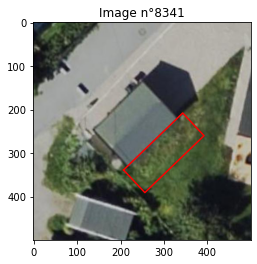

Do we accept the picture n°8341 ? (y/n/s (stop))n
not passed


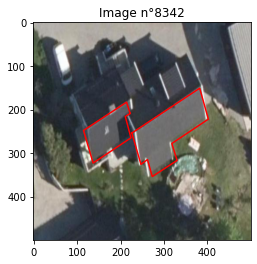

Do we accept the picture n°8342 ? (y/n/s (stop))y
passed


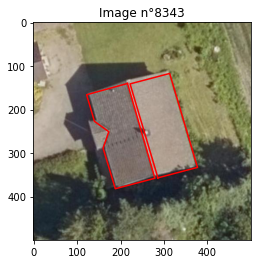

Do we accept the picture n°8343 ? (y/n/s (stop))y
passed


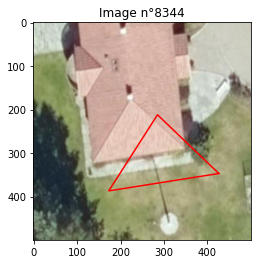

Do we accept the picture n°8344 ? (y/n/s (stop))n
not passed


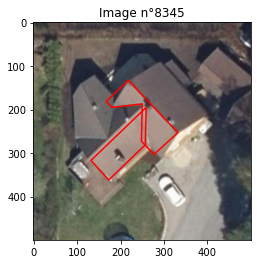

Do we accept the picture n°8345 ? (y/n/s (stop))y
passed


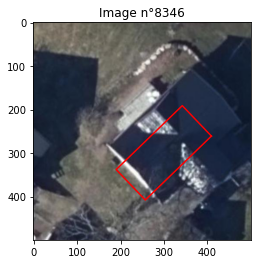

Do we accept the picture n°8346 ? (y/n/s (stop))n
not passed


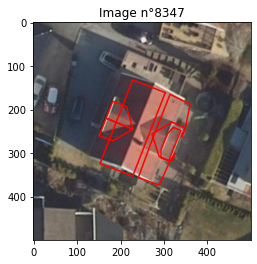

Do we accept the picture n°8347 ? (y/n/s (stop))y
passed


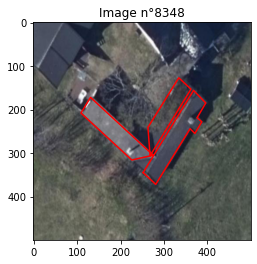

Do we accept the picture n°8348 ? (y/n/s (stop))y
passed


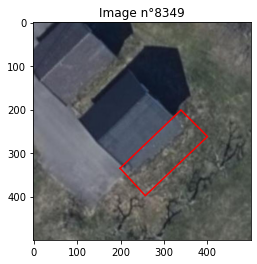

Do we accept the picture n°8349 ? (y/n/s (stop))n
not passed


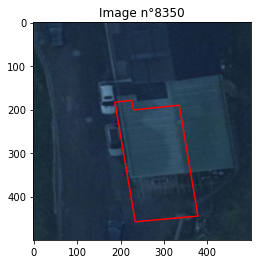

Do we accept the picture n°8350 ? (y/n/s (stop))n
not passed


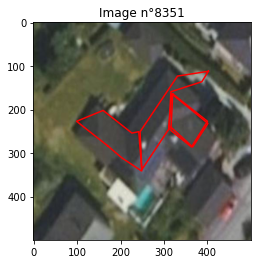

Do we accept the picture n°8351 ? (y/n/s (stop))y
passed


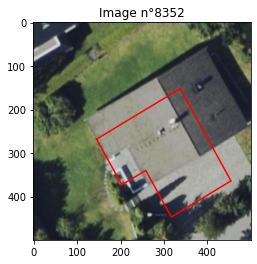

Do we accept the picture n°8352 ? (y/n/s (stop))n
not passed


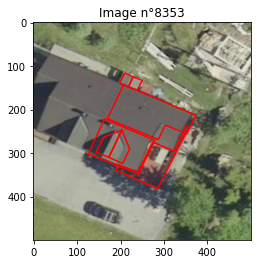

Do we accept the picture n°8353 ? (y/n/s (stop))y
passed


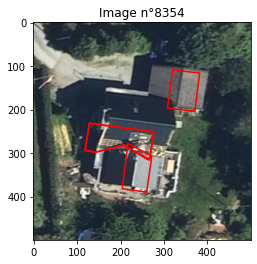

Do we accept the picture n°8354 ? (y/n/s (stop))n
not passed


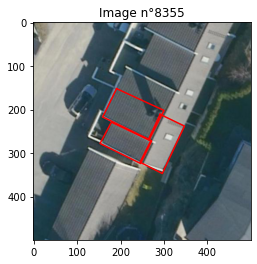

Do we accept the picture n°8355 ? (y/n/s (stop))y
passed


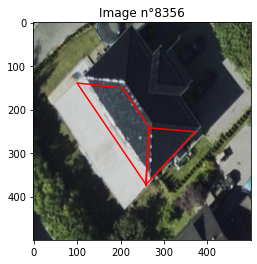

Do we accept the picture n°8356 ? (y/n/s (stop))n
not passed


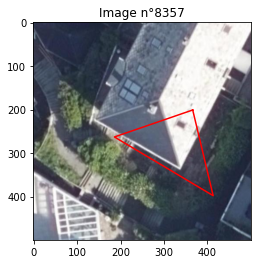

Do we accept the picture n°8357 ? (y/n/s (stop))n
not passed


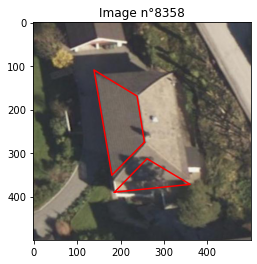

Do we accept the picture n°8358 ? (y/n/s (stop))y
passed


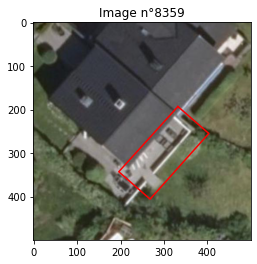

Do we accept the picture n°8359 ? (y/n/s (stop))n
not passed


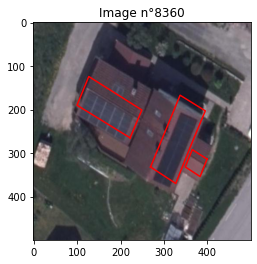

Do we accept the picture n°8360 ? (y/n/s (stop))y
passed


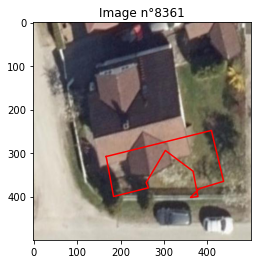

Do we accept the picture n°8361 ? (y/n/s (stop))n
not passed


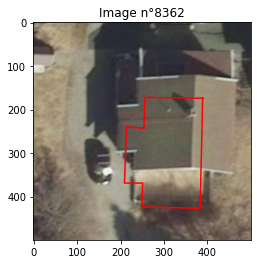

Do we accept the picture n°8362 ? (y/n/s (stop))n
not passed


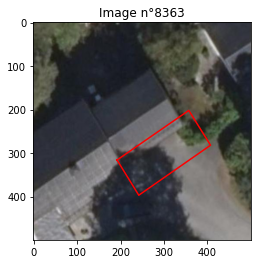

Do we accept the picture n°8363 ? (y/n/s (stop))n
not passed


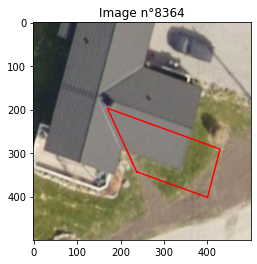

Do we accept the picture n°8364 ? (y/n/s (stop))n
not passed


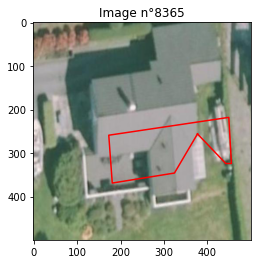

Do we accept the picture n°8365 ? (y/n/s (stop))n
not passed


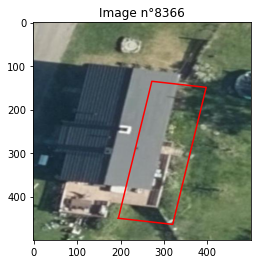

Do we accept the picture n°8366 ? (y/n/s (stop))n
not passed


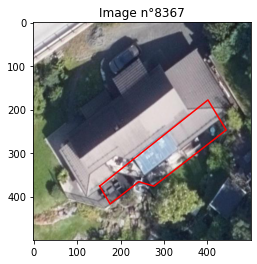

Do we accept the picture n°8367 ? (y/n/s (stop))n
not passed


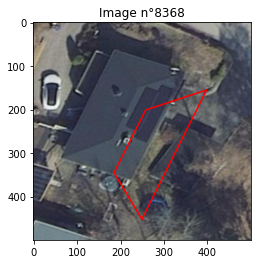

Do we accept the picture n°8368 ? (y/n/s (stop))n
not passed


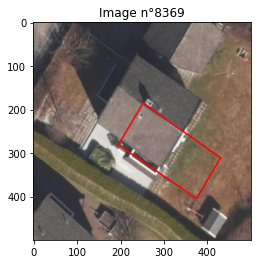

Do we accept the picture n°8369 ? (y/n/s (stop))n
not passed


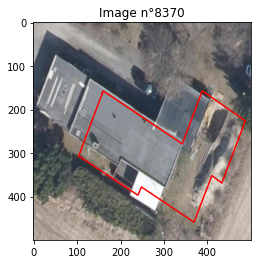

Do we accept the picture n°8370 ? (y/n/s (stop))n
not passed


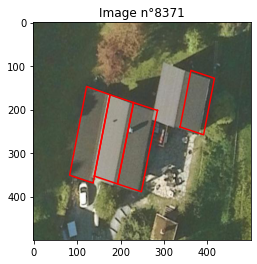

Do we accept the picture n°8371 ? (y/n/s (stop))y
passed


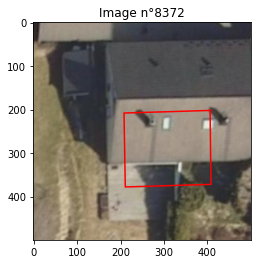

Do we accept the picture n°8372 ? (y/n/s (stop))n
not passed


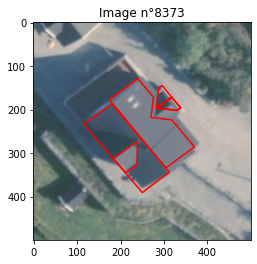

Do we accept the picture n°8373 ? (y/n/s (stop))y
passed


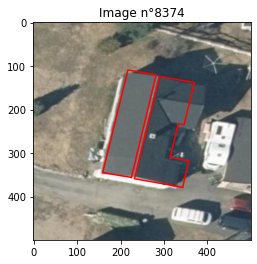

Do we accept the picture n°8374 ? (y/n/s (stop))y
passed


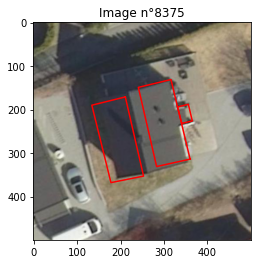

Do we accept the picture n°8375 ? (y/n/s (stop))y
passed


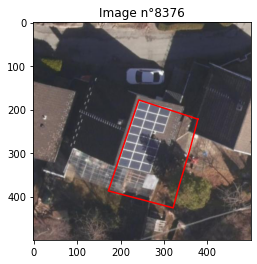

Do we accept the picture n°8376 ? (y/n/s (stop))n
not passed


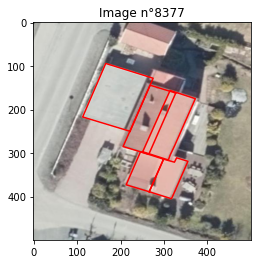

Do we accept the picture n°8377 ? (y/n/s (stop))y
passed


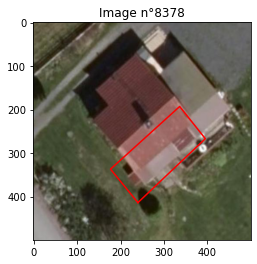

Do we accept the picture n°8378 ? (y/n/s (stop))n
not passed


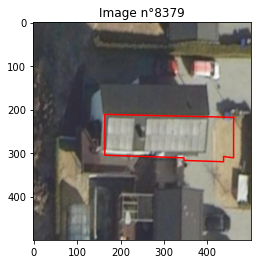

Do we accept the picture n°8379 ? (y/n/s (stop))n
not passed


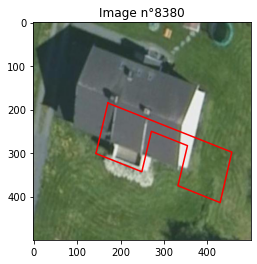

Do we accept the picture n°8380 ? (y/n/s (stop))n
not passed


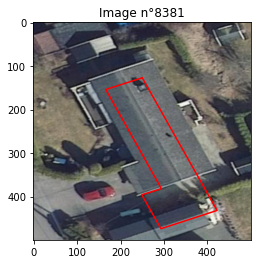

Do we accept the picture n°8381 ? (y/n/s (stop))n
not passed


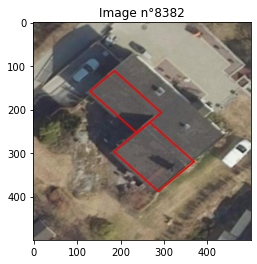

Do we accept the picture n°8382 ? (y/n/s (stop))y
passed


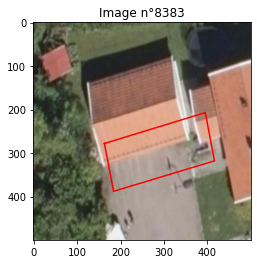

Do we accept the picture n°8383 ? (y/n/s (stop))n
not passed


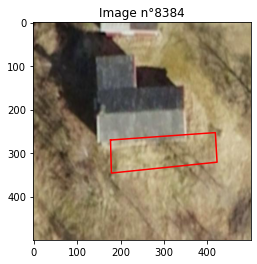

Do we accept the picture n°8384 ? (y/n/s (stop))n
not passed


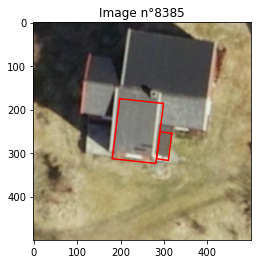

Do we accept the picture n°8385 ? (y/n/s (stop))n
not passed


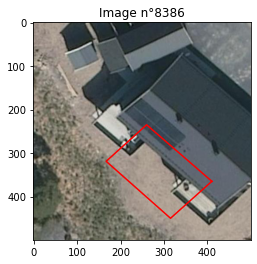

Do we accept the picture n°8386 ? (y/n/s (stop))n
not passed


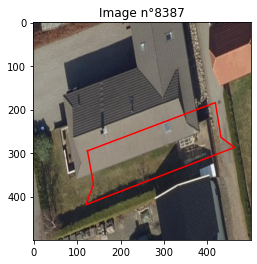

Do we accept the picture n°8387 ? (y/n/s (stop))n
not passed


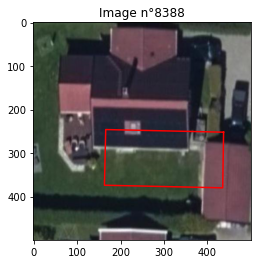

Do we accept the picture n°8388 ? (y/n/s (stop))n
not passed


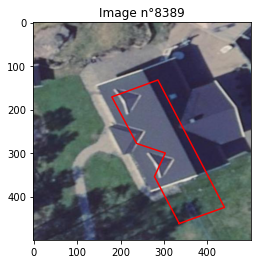

Do we accept the picture n°8389 ? (y/n/s (stop))n
not passed


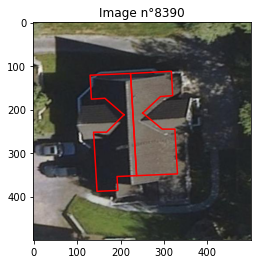

Do we accept the picture n°8390 ? (y/n/s (stop))y
passed


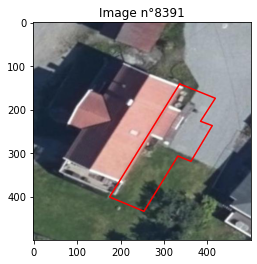

Do we accept the picture n°8391 ? (y/n/s (stop))n
not passed


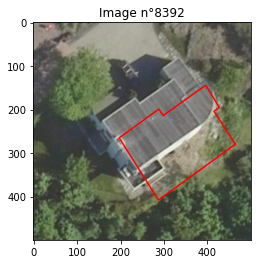

Do we accept the picture n°8392 ? (y/n/s (stop))n
not passed


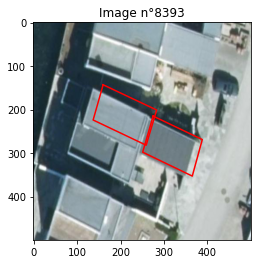

Do we accept the picture n°8393 ? (y/n/s (stop))n
not passed


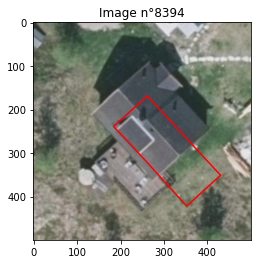

Do we accept the picture n°8394 ? (y/n/s (stop))n
not passed


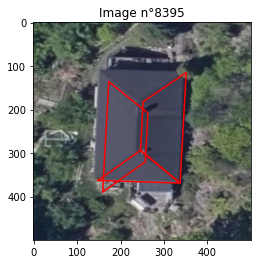

Do we accept the picture n°8395 ? (y/n/s (stop))y
passed


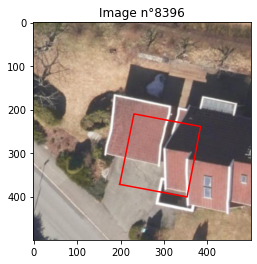

Do we accept the picture n°8396 ? (y/n/s (stop))n
not passed


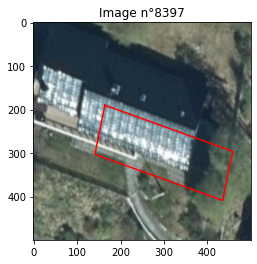

Do we accept the picture n°8397 ? (y/n/s (stop))n
not passed


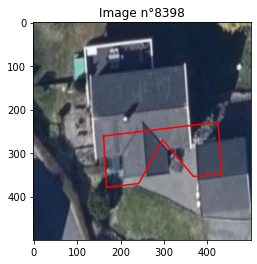

Do we accept the picture n°8398 ? (y/n/s (stop))n
not passed


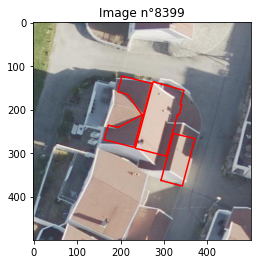

Do we accept the picture n°8399 ? (y/n/s (stop))y
passed


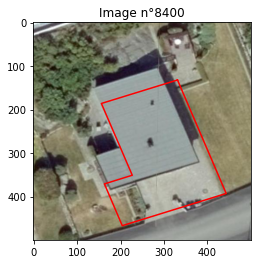

Do we accept the picture n°8400 ? (y/n/s (stop))n
not passed


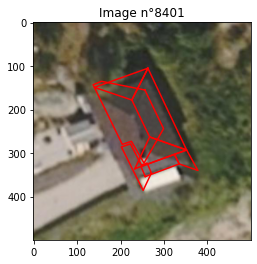

Do we accept the picture n°8401 ? (y/n/s (stop))y
passed


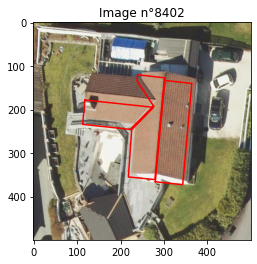

Do we accept the picture n°8402 ? (y/n/s (stop))y
passed


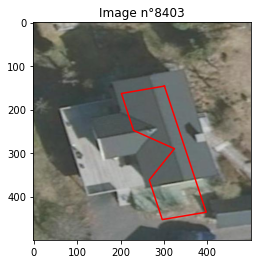

Do we accept the picture n°8403 ? (y/n/s (stop))n
not passed


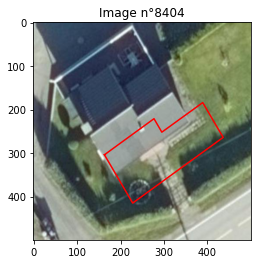

Do we accept the picture n°8404 ? (y/n/s (stop))n
not passed


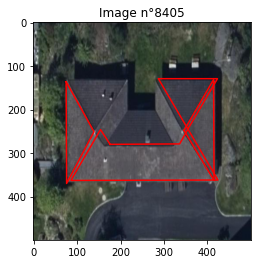

Do we accept the picture n°8405 ? (y/n/s (stop))y
passed


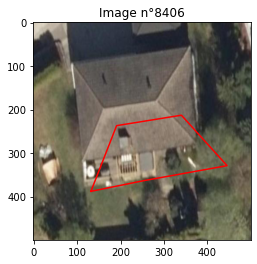

Do we accept the picture n°8406 ? (y/n/s (stop))n
not passed


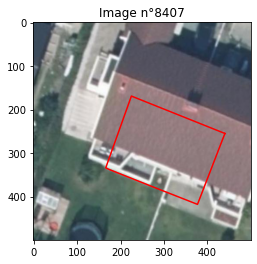

Do we accept the picture n°8407 ? (y/n/s (stop))n
not passed


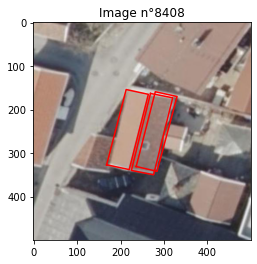

Do we accept the picture n°8408 ? (y/n/s (stop))y
passed


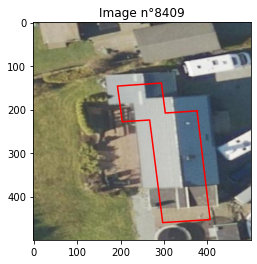

Do we accept the picture n°8409 ? (y/n/s (stop))n
not passed


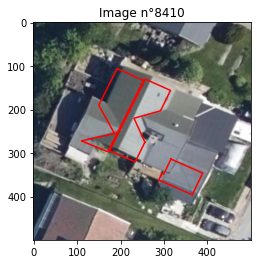

Do we accept the picture n°8410 ? (y/n/s (stop))n
not passed


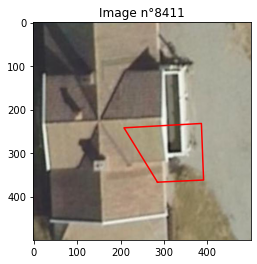

Do we accept the picture n°8411 ? (y/n/s (stop))n
not passed


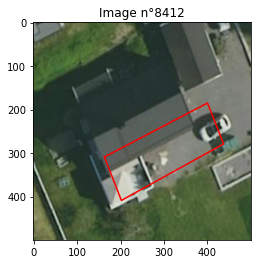

Do we accept the picture n°8412 ? (y/n/s (stop))n
not passed


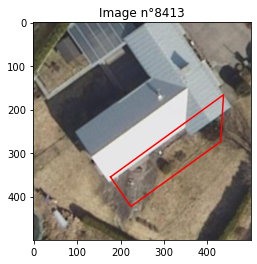

Do we accept the picture n°8413 ? (y/n/s (stop))n
not passed


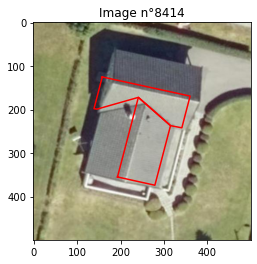

Do we accept the picture n°8414 ? (y/n/s (stop))y
passed


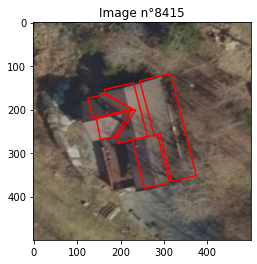

Do we accept the picture n°8415 ? (y/n/s (stop))y
passed


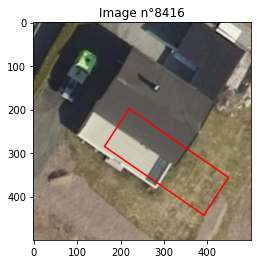

Do we accept the picture n°8416 ? (y/n/s (stop))n
not passed


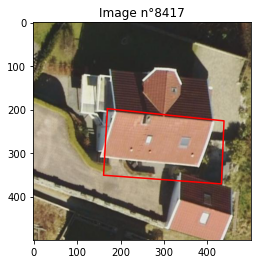

Do we accept the picture n°8417 ? (y/n/s (stop))n
not passed


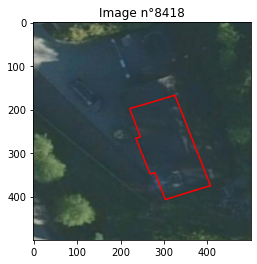

Do we accept the picture n°8418 ? (y/n/s (stop))n
not passed


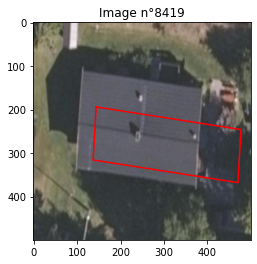

Do we accept the picture n°8419 ? (y/n/s (stop))n
not passed


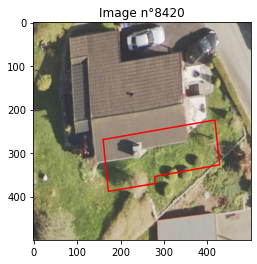

Do we accept the picture n°8420 ? (y/n/s (stop))n
not passed


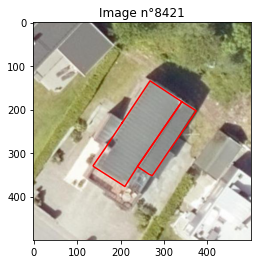

Do we accept the picture n°8421 ? (y/n/s (stop))y
passed


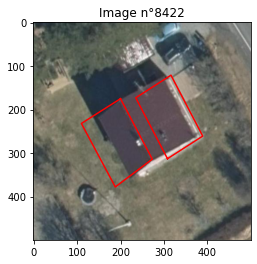

Do we accept the picture n°8422 ? (y/n/s (stop))n
not passed


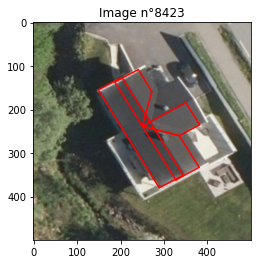

Do we accept the picture n°8423 ? (y/n/s (stop))n
not passed


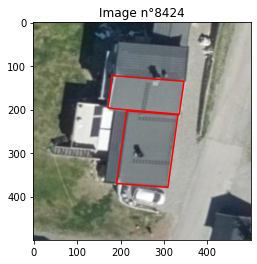

Do we accept the picture n°8424 ? (y/n/s (stop))y
passed


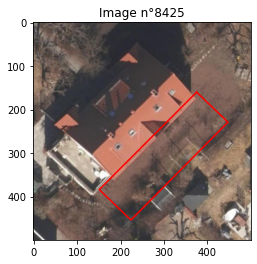

Do we accept the picture n°8425 ? (y/n/s (stop))n
not passed


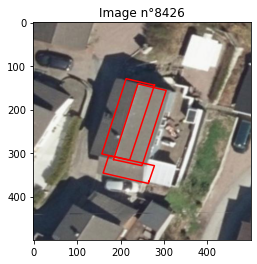

Do we accept the picture n°8426 ? (y/n/s (stop))n
not passed


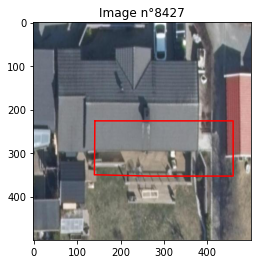

Do we accept the picture n°8427 ? (y/n/s (stop))n
not passed


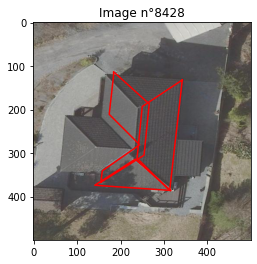

Do we accept the picture n°8428 ? (y/n/s (stop))y
passed


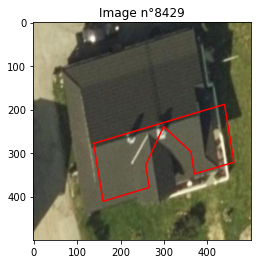

Do we accept the picture n°8429 ? (y/n/s (stop))n
not passed


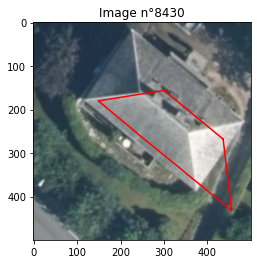

Do we accept the picture n°8430 ? (y/n/s (stop))n
not passed


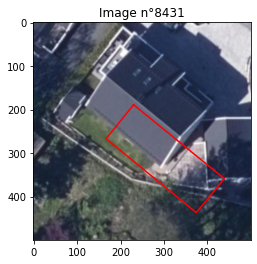

Do we accept the picture n°8431 ? (y/n/s (stop))n
not passed


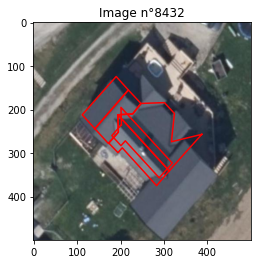

Do we accept the picture n°8432 ? (y/n/s (stop))y
passed


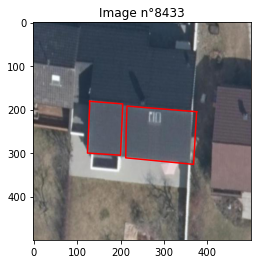

Do we accept the picture n°8433 ? (y/n/s (stop))y
passed


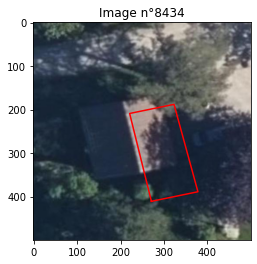

Do we accept the picture n°8434 ? (y/n/s (stop))n
not passed


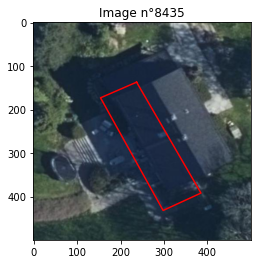

Do we accept the picture n°8435 ? (y/n/s (stop))n
not passed


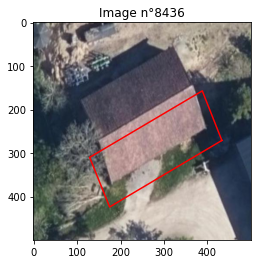

Do we accept the picture n°8436 ? (y/n/s (stop))n
not passed


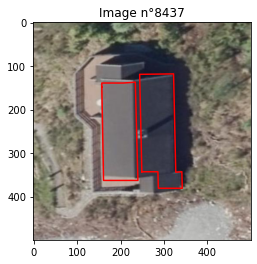

Do we accept the picture n°8437 ? (y/n/s (stop))y
passed


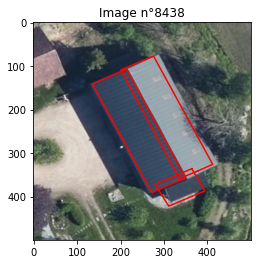

Do we accept the picture n°8438 ? (y/n/s (stop))y
passed


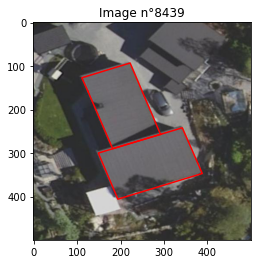

Do we accept the picture n°8439 ? (y/n/s (stop))y
passed


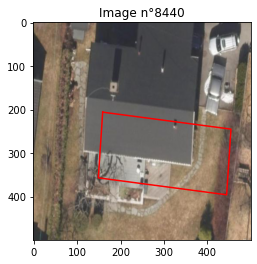

Do we accept the picture n°8440 ? (y/n/s (stop))n
not passed


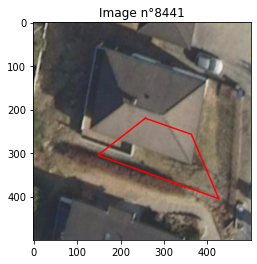

Do we accept the picture n°8441 ? (y/n/s (stop))n
not passed


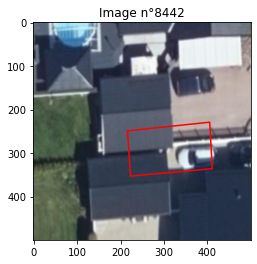

Do we accept the picture n°8442 ? (y/n/s (stop))n
not passed


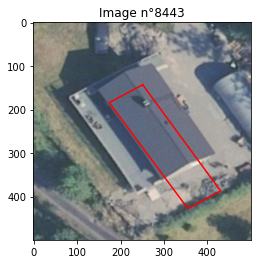

Do we accept the picture n°8443 ? (y/n/s (stop))n
not passed


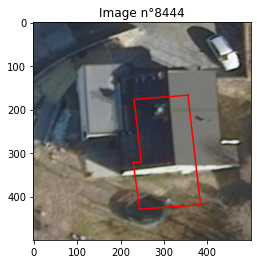

Do we accept the picture n°8444 ? (y/n/s (stop))n
not passed


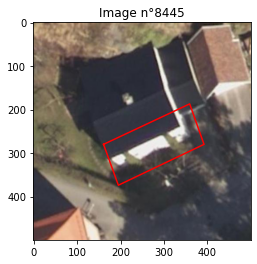

Do we accept the picture n°8445 ? (y/n/s (stop))n
not passed


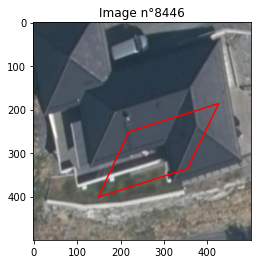

Do we accept the picture n°8446 ? (y/n/s (stop))n
not passed


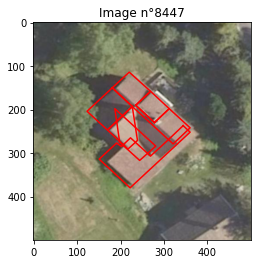

Do we accept the picture n°8447 ? (y/n/s (stop))y
passed


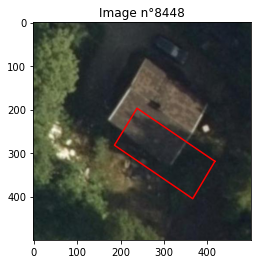

Do we accept the picture n°8448 ? (y/n/s (stop))n
not passed


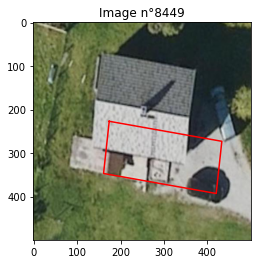

Do we accept the picture n°8449 ? (y/n/s (stop))n
not passed


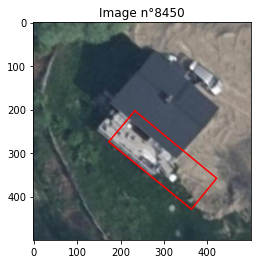

Do we accept the picture n°8450 ? (y/n/s (stop))n
not passed


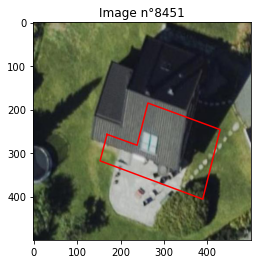

Do we accept the picture n°8451 ? (y/n/s (stop))n
not passed


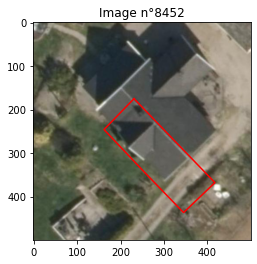

Do we accept the picture n°8452 ? (y/n/s (stop))n
not passed


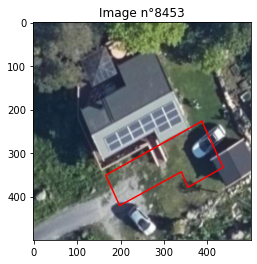

Do we accept the picture n°8453 ? (y/n/s (stop))n
not passed


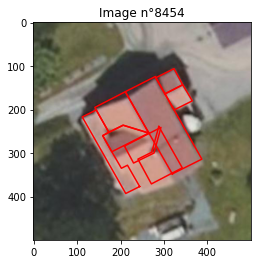

Do we accept the picture n°8454 ? (y/n/s (stop))y
passed


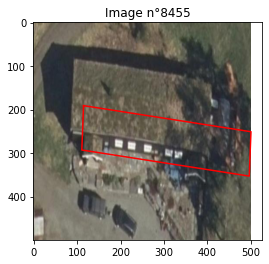

Do we accept the picture n°8455 ? (y/n/s (stop))n
not passed


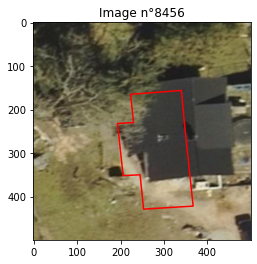

Do we accept the picture n°8456 ? (y/n/s (stop))n
not passed


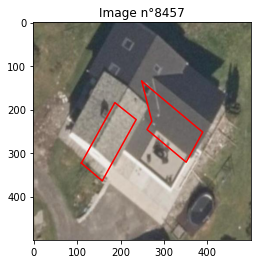

Do we accept the picture n°8457 ? (y/n/s (stop))n
not passed


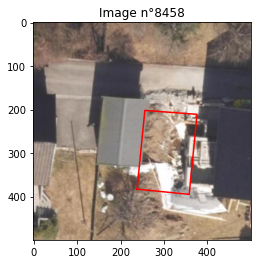

Do we accept the picture n°8458 ? (y/n/s (stop))n
not passed


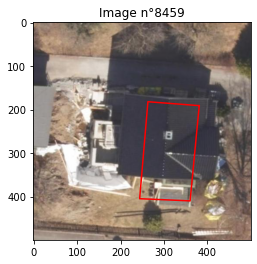

Do we accept the picture n°8459 ? (y/n/s (stop))n
not passed


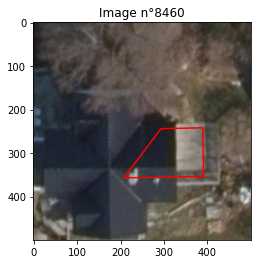

Do we accept the picture n°8460 ? (y/n/s (stop))n
not passed


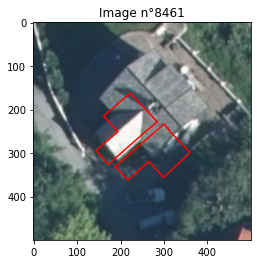

Do we accept the picture n°8461 ? (y/n/s (stop))n
not passed


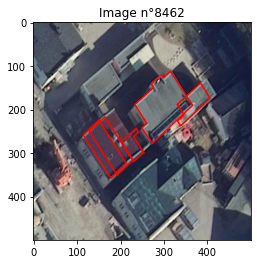

Do we accept the picture n°8462 ? (y/n/s (stop))y
passed


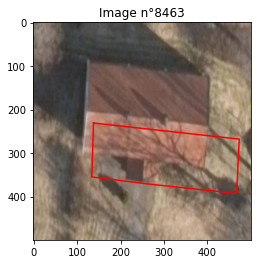

Do we accept the picture n°8463 ? (y/n/s (stop))n
not passed


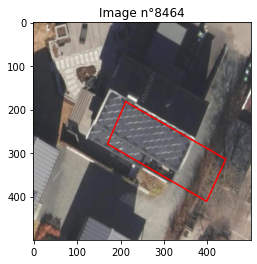

Do we accept the picture n°8464 ? (y/n/s (stop))n
not passed


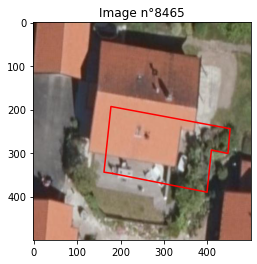

Do we accept the picture n°8465 ? (y/n/s (stop))n
not passed


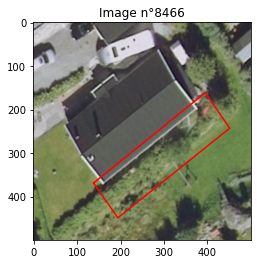

Do we accept the picture n°8466 ? (y/n/s (stop))n
not passed


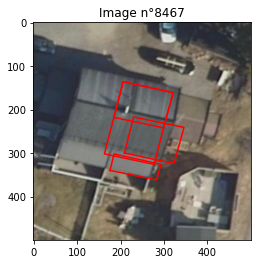

Do we accept the picture n°8467 ? (y/n/s (stop))n
not passed


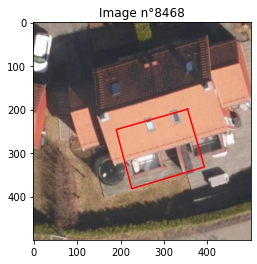

Do we accept the picture n°8468 ? (y/n/s (stop))n
not passed


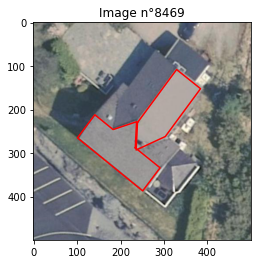

Do we accept the picture n°8469 ? (y/n/s (stop))y
passed


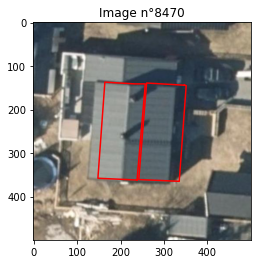

Do we accept the picture n°8470 ? (y/n/s (stop))n
not passed


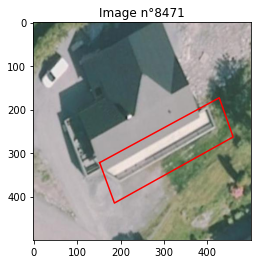

Do we accept the picture n°8471 ? (y/n/s (stop))n
not passed


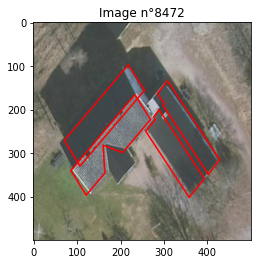

Do we accept the picture n°8472 ? (y/n/s (stop))y
passed


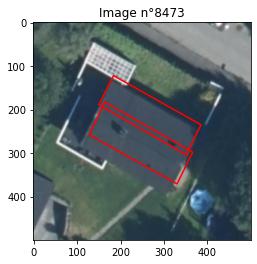

Do we accept the picture n°8473 ? (y/n/s (stop))y
passed


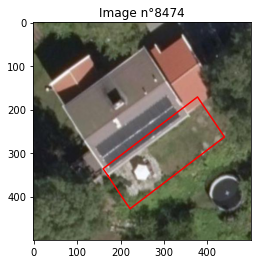

Do we accept the picture n°8474 ? (y/n/s (stop))n
not passed


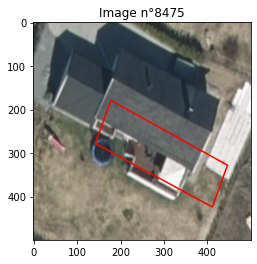

Do we accept the picture n°8475 ? (y/n/s (stop))n
not passed


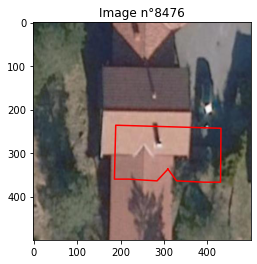

Do we accept the picture n°8476 ? (y/n/s (stop))n
not passed


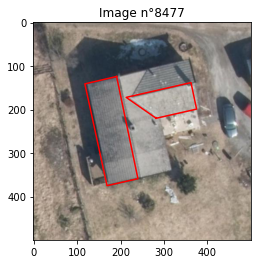

Do we accept the picture n°8477 ? (y/n/s (stop))y
passed


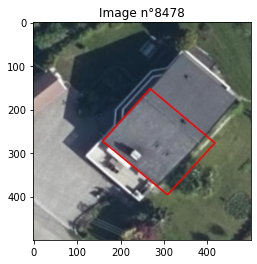

Do we accept the picture n°8478 ? (y/n/s (stop))n
not passed


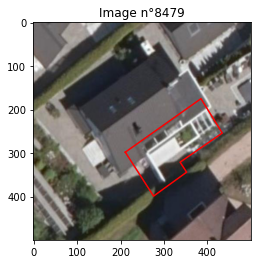

Do we accept the picture n°8479 ? (y/n/s (stop))n
not passed


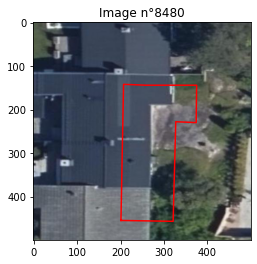

Do we accept the picture n°8480 ? (y/n/s (stop))n
not passed


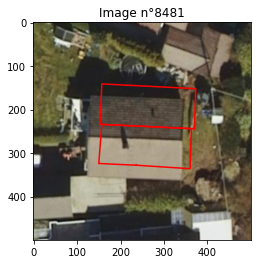

Do we accept the picture n°8481 ? (y/n/s (stop))n
not passed


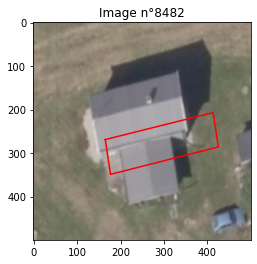

Do we accept the picture n°8482 ? (y/n/s (stop))n
not passed


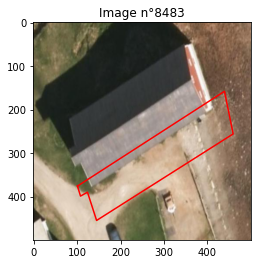

Do we accept the picture n°8483 ? (y/n/s (stop))n
not passed


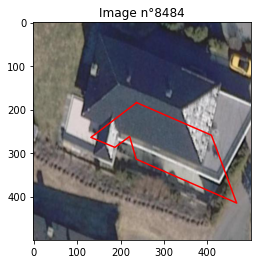

Do we accept the picture n°8484 ? (y/n/s (stop))n
not passed


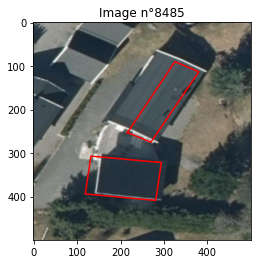

Do we accept the picture n°8485 ? (y/n/s (stop))n
not passed


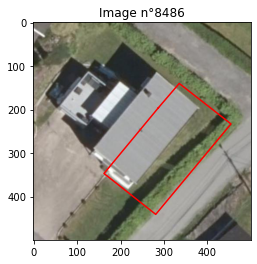

Do we accept the picture n°8486 ? (y/n/s (stop))n
not passed


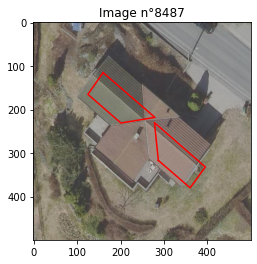

Do we accept the picture n°8487 ? (y/n/s (stop))n
not passed


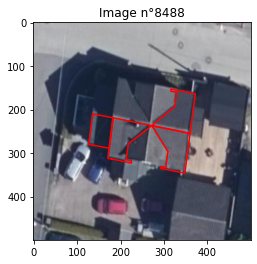

Do we accept the picture n°8488 ? (y/n/s (stop))y
passed


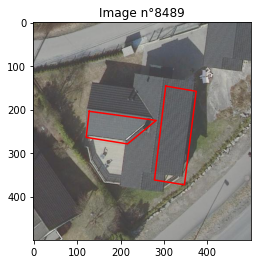

Do we accept the picture n°8489 ? (y/n/s (stop))y
passed


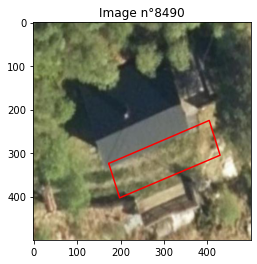

Do we accept the picture n°8490 ? (y/n/s (stop))n
not passed


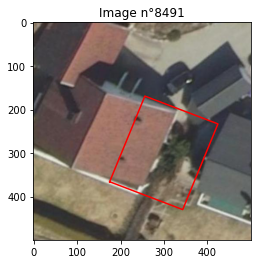

Do we accept the picture n°8491 ? (y/n/s (stop))n
not passed


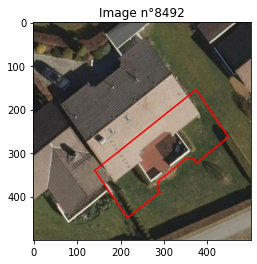

Do we accept the picture n°8492 ? (y/n/s (stop))n
not passed


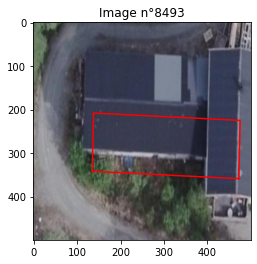

Do we accept the picture n°8493 ? (y/n/s (stop))n
not passed


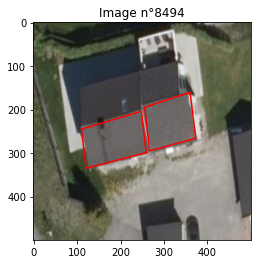

Do we accept the picture n°8494 ? (y/n/s (stop))y
passed


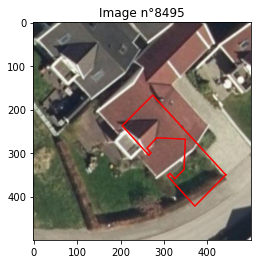

Do we accept the picture n°8495 ? (y/n/s (stop))n
not passed


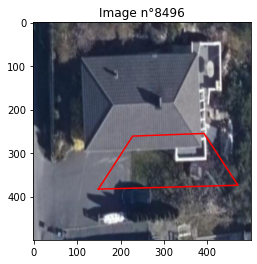

Do we accept the picture n°8496 ? (y/n/s (stop))n
not passed


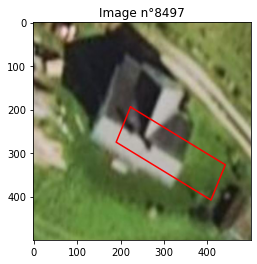

Do we accept the picture n°8497 ? (y/n/s (stop))n
not passed


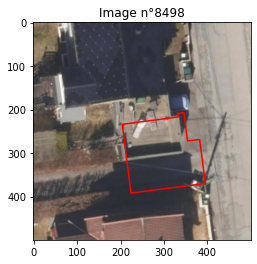

Do we accept the picture n°8498 ? (y/n/s (stop))n
not passed


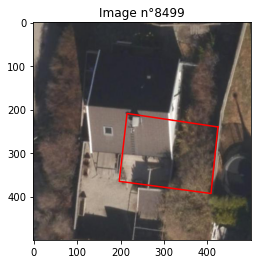

Do we accept the picture n°8499 ? (y/n/s (stop))n
not passed


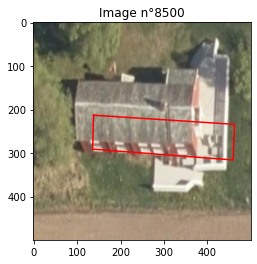

Do we accept the picture n°8500 ? (y/n/s (stop))s
exiting session
Last classified index: 8499


In [9]:
start_index = 8000
FINISH = False

#create DataFrame
valid_df = pd.DataFrame(columns=['original_index','image_path','mask_path','valid'])
VALIDATED_CSV = "./data/paths_df_validated.csv"

isExist = os.path.exists(VALIDATED_CSV)
if not isExist:
    valid_df.to_csv(VALIDATED_CSV)
    print("Target csv created")

old_valid = pd.read_csv(VALIDATED_CSV)
 
i = start_index
while not FINISH :
    
    # If the i_th image is already done, we go to the next one
    if i in old_valid['original_index'].values:
        i += 1
        continue
    
    # We select the image
    image = data.iloc[i]
    image_path = image.building_id + '-b15-otovowms.jpeg'
    mask_path = image.building_id
    
    # What we will append in the dataframe
    dict_to_append = {
        'original_index': [i],
        'image_path': [image_path],
        'mask_path': [mask_path],
        'valid': [False]
    }
    
    # We show the image that will be evaluated 
    plt.imshow( plt.imread('./data/' + image_path) )
    image_reader(image)
    plt.draw()
    plt.title(f'Image n°{i}')
    plt.pause(0.2)
    
    # We check if we take it
    VALID_KEY_PRESS = False
                
    while not VALID_KEY_PRESS : 
        key = input(f'Do we accept the picture n°{i} ? (y/n/s (stop))')
        if (key == 'y') :
            dict_to_append['valid'] = [True]
            new_row = pd.DataFrame.from_dict(dict_to_append)
            valid_df = pd.concat([valid_df, new_row], ignore_index=True)
            VALID_KEY_PRESS = True
            print('passed')
        elif (key == 'n') :
            dict_to_append['valid'] = [False]
            new_row = pd.DataFrame.from_dict(dict_to_append)
            valid_df = pd.concat([valid_df, new_row], ignore_index=True)
            VALID_KEY_PRESS = True
            print('not passed')
        elif (key == 's') : 
            VALID_KEY_PRESS = True
            FINISH = True
            print('exiting session')
        else :
            print('Try Again')
            
    i += 1
    plt.close()
    
print(f"Last classified index: {valid_df['original_index'].iloc[-1]}")

valid_df.to_csv(VALIDATED_CSV, mode='a', header=False)

In [13]:
info = pd.read_csv(VALIDATED_CSV)
info

,Unnamed: 0,original_index,image_path,mask_path,valid
0,0,3000,c40c059e-4466-4257-bcec-3ceff2ed5d4a-b15-otovo...,c40c059e-4466-4257-bcec-3ceff2ed5d4a,True
1,1,3001,0ff4eee8-c7d3-40fc-a5a1-b8077d96d8fb-b15-otovo...,0ff4eee8-c7d3-40fc-a5a1-b8077d96d8fb,True
2,2,3002,dbabb5db-7e8e-419f-96ed-8f21786b87f7-b15-otovo...,dbabb5db-7e8e-419f-96ed-8f21786b87f7,True
3,3,3003,87b9fb55-b60f-413e-ba44-5aa19e698f21-b15-otovo...,87b9fb55-b60f-413e-ba44-5aa19e698f21,True
4,4,3004,cb1bd640-a026-45d7-a650-a6fb924b17d0-b15-otovo...,cb1bd640-a026-45d7-a650-a6fb924b17d0,True
...,...,...,...,...,...
2995,195,8495,c76a6331-615e-447d-aace-6cdb96984f0f-b15-otovo...,c76a6331-615e-447d-aace-6cdb96984f0f,False
2996,196,8496,bb6109be-cabc-4672-bfab-6138d874a96e-b15-otovo...,bb6109be-cabc-4672-bfab-6138d874a96e,False
2997,197,8497,b81b23f4-1ca0-4f41-9c21-a17e0d3d5477-b15-otovo...,b81b23f4-1ca0-4f41-9c21-a17e0d3d5477,False
2998,198,8498,d363a012-2f7e-4655-9671-480258e8016c-b15-otovo...,d363a012-2f7e-4655-9671-480258e8016c,False


In [14]:
(info['valid']*1).sum()

1170